In [9]:
import pandas as pd
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1 import make_axes_locatable
import geopandas as gpd
from matplotlib.pyplot import figure
import seaborn as sns
import numpy as np

In [10]:
gdf = gpd.read_file('eigenvector-centrality.shp')

In [11]:
gdf.columns

Index(['osmid', 'y', 'x', 'street_cou', 'highway', 'ref', 'ec', 'index_righ',
       'GEOID', 'B01003_001', 'B19025A_00', 'NAME', 'state', 'county', 'tract',
       'popden', 'invincome', 'popden_nor', 'invincome_', 'w_ec_pden',
       'w_ec_invin', 'w_ec_both', 'geometry'],
      dtype='object')

In [12]:
gdf.head()

,osmid,y,x,street_cou,highway,ref,ec,index_righ,GEOID,B01003_001,...,county,tract,popden,invincome,popden_nor,invincome_,w_ec_pden,w_ec_invin,w_ec_both,geometry
0,61729162,42.066328,-72.861139,3,None,None,0.0,38,25013813000,7246.0,...,013,813000,7.698132,4.202360e-09,0.000565,0.002576,0.0,0.0,0.0,POINT (-8110864.914 5170920.181)
1,61729228,42.078876,-72.960663,1,None,None,0.0,38,25013813000,7246.0,...,013,813000,7.698132,4.202360e-09,0.000565,0.002576,0.0,0.0,0.0,POINT (-8121943.864 5172801.974)
2,61729236,42.066242,-72.850392,3,None,None,0.0,38,25013813000,7246.0,...,013,813000,7.698132,4.202360e-09,0.000565,0.002576,0.0,0.0,0.0,POINT (-8109668.519 5170907.360)
3,61729302,42.123144,-72.950999,3,None,None,0.0,38,25013813000,7246.0,...,013,813000,7.698132,4.202360e-09,0.000565,0.002576,0.0,0.0,0.0,POINT (-8120868.062 5179443.704)
4,61729370,42.040227,-72.881374,3,None,None,0.0,38,25013813000,7246.0,...,013,813000,7.698132,4.202360e-09,0.000565,0.002576,0.0,0.0,0.0,POINT (-8113117.420 5167007.100)


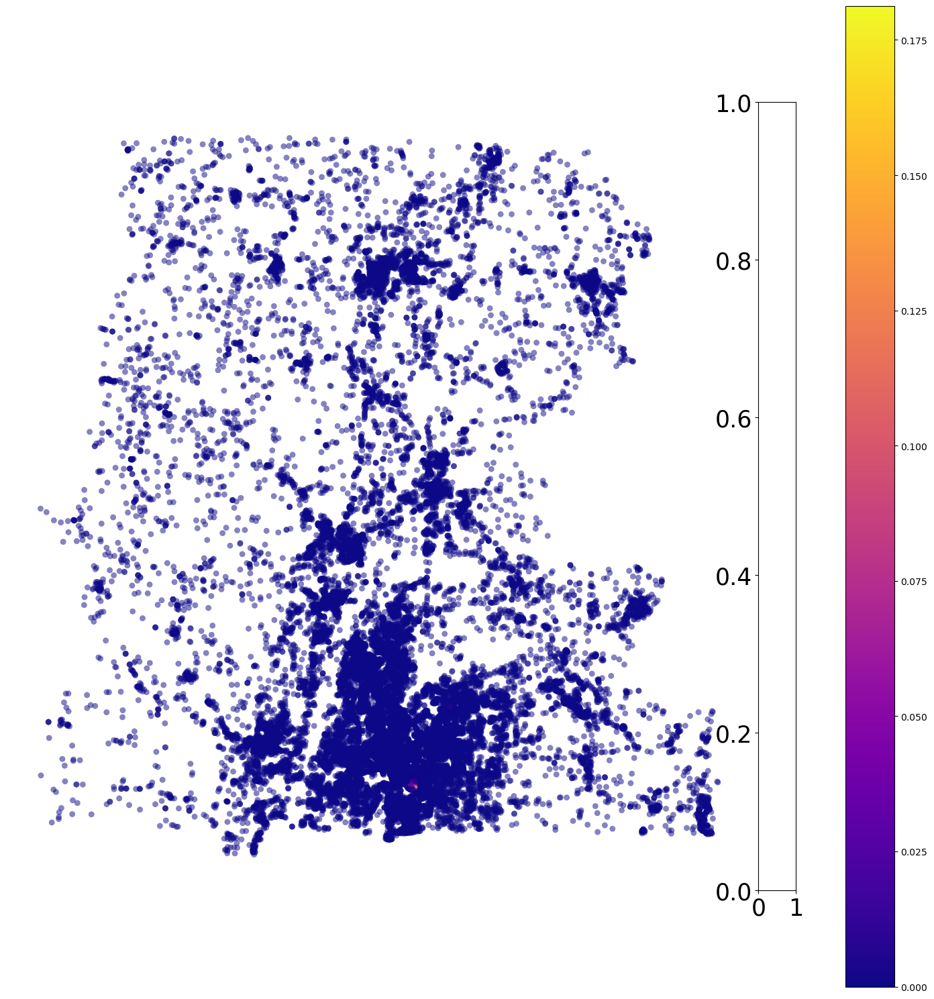

In [13]:
fig, ax = plt.subplots(figsize=(15,15))
divider = make_axes_locatable(ax)
cax = divider.append_axes("right", size="5%", pad=0.1)
gdf.plot('w_ec_pden', cmap='plasma', alpha=0.5, ax=ax, linewidth=.25,legend=True)
ax.axis('off')
cax.tick_params(labelsize='25')
plt.tight_layout()
plt.savefig('pv-w_ec_popden.png',dpi=120)

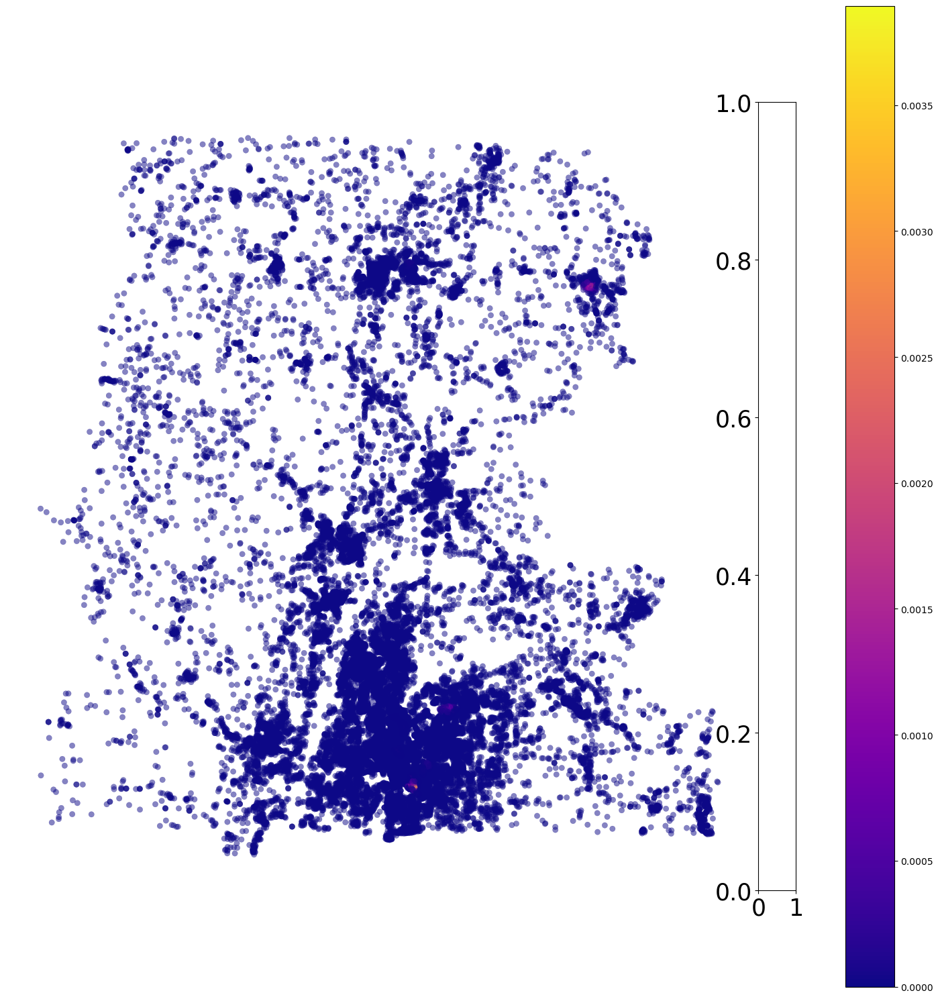

In [14]:
fig, ax = plt.subplots(figsize=(15,15))
divider = make_axes_locatable(ax)
cax = divider.append_axes("right", size="5%", pad=0.1)
gdf.plot('w_ec_invin', cmap='plasma', alpha=0.5, ax=ax, linewidth=.25,legend=True)
ax.axis('off')
cax.tick_params(labelsize='25')
plt.tight_layout()
plt.savefig('pv-w_ec_invinc.png',dpi=120)

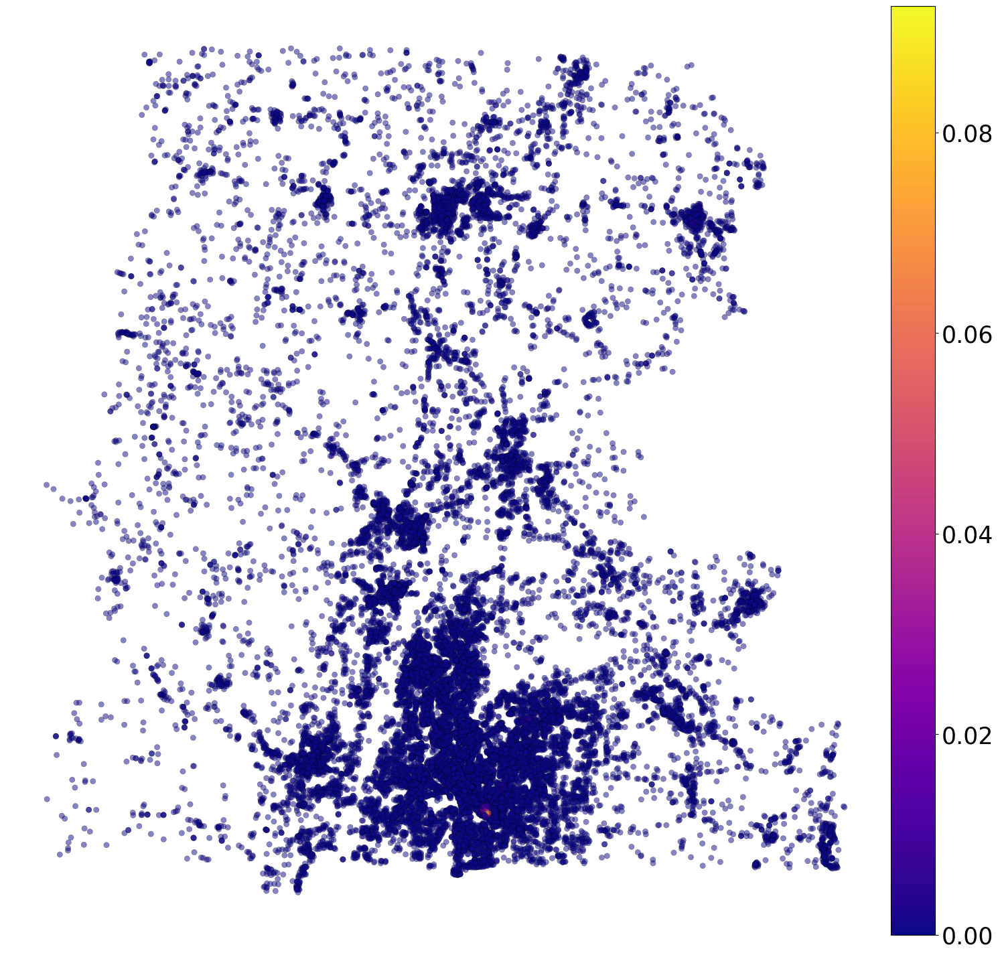

In [15]:
fig, ax = plt.subplots(figsize=(15,15))
divider = make_axes_locatable(ax)
cax = divider.append_axes("right", size="5%", pad=0.1)
gdf.plot('w_ec_both', cmap='plasma', alpha=0.5, ax=ax, linewidth=.25, edgecolor='k',legend=True, cax=cax)
ax.axis('off')
cax.tick_params(labelsize='25')
plt.tight_layout()
plt.savefig('pv-w_ec_both.png',dpi=120)

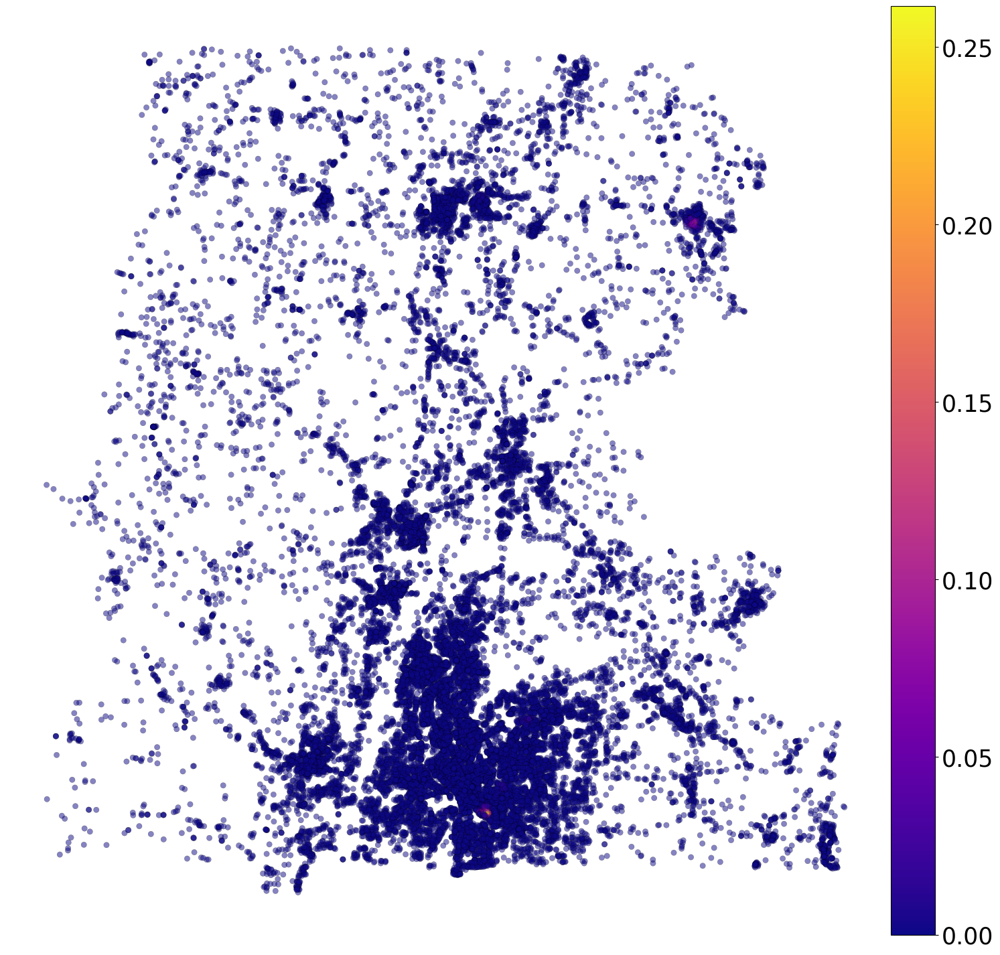

In [16]:
fig, ax = plt.subplots(figsize=(15,15))
divider = make_axes_locatable(ax)
cax = divider.append_axes("right", size="5%", pad=0.1)
gdf.plot('ec', cmap='plasma', alpha=0.5, ax=ax, linewidth=.25, edgecolor='k',legend=True, cax=cax)
ax.axis('off')
cax.tick_params(labelsize='25')
plt.tight_layout()
plt.savefig('pv-ec.png',dpi=120)

In [17]:
gdf = gpd.read_file('page-rank.shp')

In [18]:
gdf.columns

Index(['osmid', 'y', 'x', 'street_cou', 'highway', 'ref', 'rank', 'index_righ',
       'GEOID', 'B01003_001', 'B19025A_00', 'NAME', 'state', 'county', 'tract',
       'popden', 'invincome', 'popden_nor', 'invinc_nor', 'w_rank_pde',
       'w_rank_inv', 'w_rank_bot', 'geometry'],
      dtype='object')

C:\Users\Mahsa\AppData\Local\Temp\ipykernel_41676\2652335373.py:27: MatplotlibDeprecationWarning: Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.
  cbar = plt.colorbar(sm)


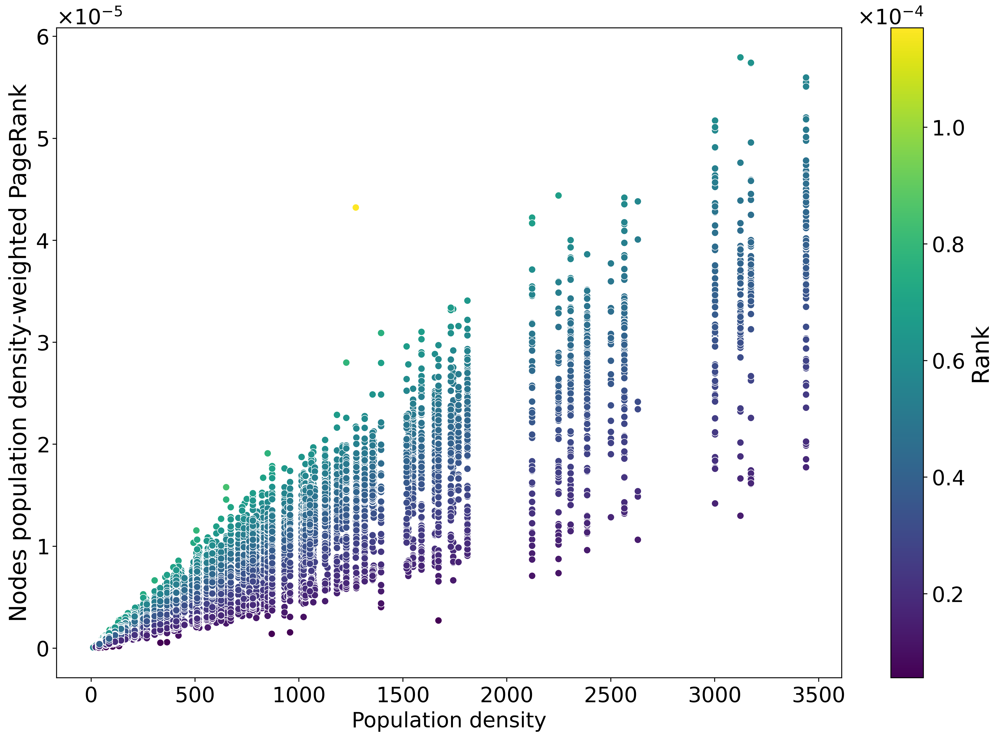

In [52]:
import matplotlib.pyplot as plt
import matplotlib.ticker as mticker

figure(figsize=(15, 10), dpi=400)
hues = gdf['rank']

fig = sns.scatterplot(data=gdf, x='popden', y='w_rank_pde', hue=hues, palette='viridis')
fig.set_xlabel('Population density', fontsize=18)
fig.set_ylabel('Nodes population density-weighted PageRank', fontsize=20)
plt.xticks(fontsize=18)
plt.yticks(fontsize=18)

# Set scientific notation for axes
plt.gca().yaxis.set_major_formatter(mticker.ScalarFormatter(useMathText=True, useOffset=False))
plt.gca().yaxis.get_major_formatter().set_scientific(True)
plt.gca().yaxis.get_major_formatter().set_powerlimits((0, 0))

# Remove the current legend
plt.gca().legend_.remove()

# Create a custom legend with scientific notation
norm = plt.Normalize(hues.min(), hues.max())
sm = plt.cm.ScalarMappable(cmap='viridis', norm=norm)
sm.set_array([])

# Set the legend title, font size, and scientific notation format
cbar = plt.colorbar(sm)
cbar.set_label('Rank', fontsize=20)
cbar.ax.yaxis.set_major_formatter(mticker.ScalarFormatter(useMathText=True))
cbar.ax.yaxis.get_major_formatter().set_scientific(True)
cbar.ax.yaxis.get_major_formatter().set_powerlimits((0, 0))
fig.yaxis.offsetText.set_fontsize(18)
cax.yaxis.offsetText.set_fontsize(18)
cbar.ax.tick_params(labelsize=18)
cbar.ax.yaxis.offsetText.set_fontsize(18)


plt.savefig('popdens-vs-weighted-rank.png', dpi=400, bbox_inches='tight')
plt.show()


C:\Users\Mahsa\AppData\Local\Temp\ipykernel_41676\3604928292.py:24: MatplotlibDeprecationWarning: Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.
  cbar = plt.colorbar(sm)


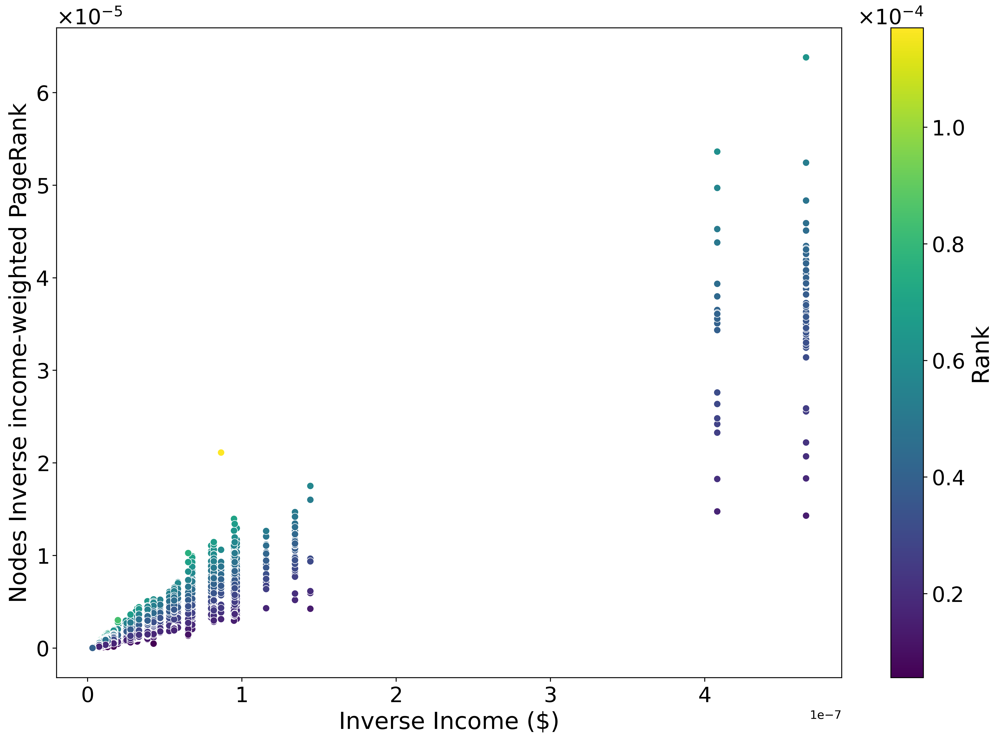

In [53]:
figure(figsize=(15, 10), dpi=400)
hues = gdf['rank']

fig = sns.scatterplot(data=gdf, x='invincome', y='w_rank_inv', hue=hues, palette='viridis')
fig.set_xlabel('Inverse Income ($)', fontsize=20)
fig.set_ylabel('Nodes Inverse income-weighted PageRank', fontsize=20)
plt.xticks(fontsize=18)
plt.yticks(fontsize=18)

# Set scientific notation for axes
plt.gca().yaxis.set_major_formatter(mticker.ScalarFormatter(useMathText=True, useOffset=False))
plt.gca().yaxis.get_major_formatter().set_scientific(True)
plt.gca().yaxis.get_major_formatter().set_powerlimits((0, 0))

# Remove the current legend
plt.gca().legend_.remove()

# Create a custom legend with scientific notation
norm = plt.Normalize(hues.min(), hues.max())
sm = plt.cm.ScalarMappable(cmap='viridis', norm=norm)
sm.set_array([])

# Set the legend title, font size, and scientific notation format
cbar = plt.colorbar(sm)
cbar.set_label('Rank', fontsize=20)
cbar.ax.yaxis.set_major_formatter(mticker.ScalarFormatter(useMathText=True))
cbar.ax.yaxis.get_major_formatter().set_scientific(True)
cbar.ax.yaxis.get_major_formatter().set_powerlimits((0, 0))
fig.yaxis.offsetText.set_fontsize(18)
cax.yaxis.offsetText.set_fontsize(18)
cbar.ax.tick_params(labelsize=18)
cbar.ax.yaxis.offsetText.set_fontsize(18)



plt.savefig('invincome-vs-weighted-rank.png', dpi=400, bbox_inches='tight')
plt.show()


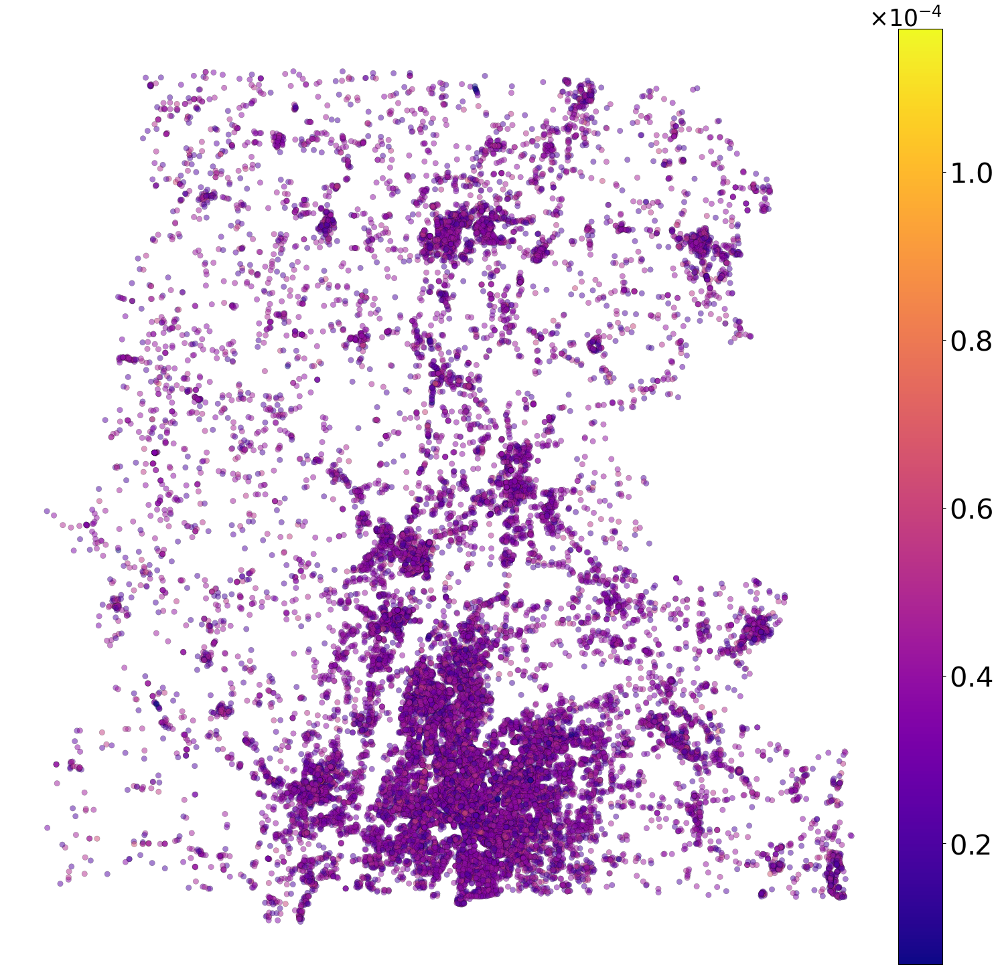

In [37]:
import matplotlib.ticker as mticker
from mpl_toolkits.axes_grid1 import make_axes_locatable

fig, ax = plt.subplots(figsize=(15, 15))
divider = make_axes_locatable(ax)
cax = divider.append_axes("right", size="5%", pad=0.1)
gdf.plot('rank', cmap='plasma', alpha=0.5, ax=ax, linewidth=.25, edgecolor='k', legend=True, cax=cax)
ax.axis('off')

# Set scientific notation for the colorbar tick labels
cax.yaxis.set_major_formatter(mticker.ScalarFormatter(useMathText=True, useOffset=False))
cax.yaxis.get_major_formatter().set_scientific(True)
cax.yaxis.get_major_formatter().set_powerlimits((0, 0))

cax.tick_params(labelsize='30')
cax.yaxis.offsetText.set_fontsize(25)

plt.tight_layout()

plt.savefig('pv-page-rank.png', dpi=120)

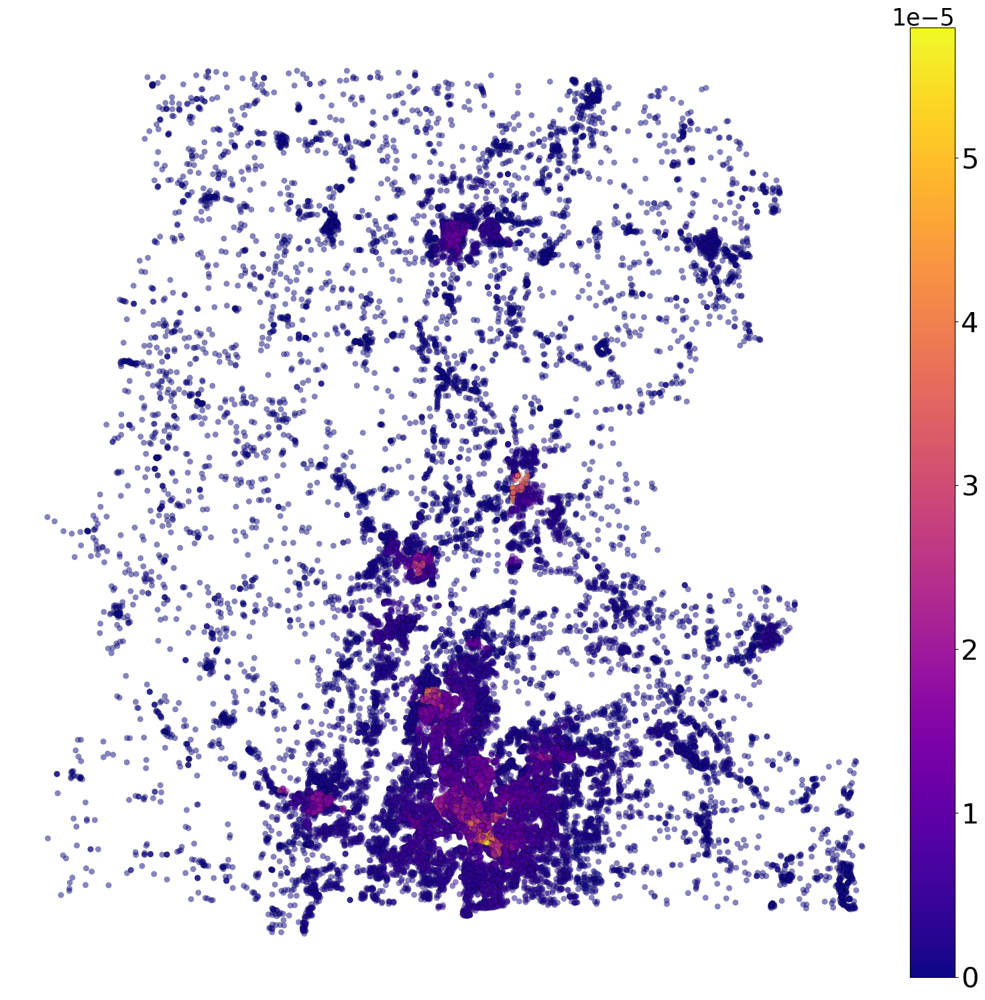

In [38]:
fig, ax = plt.subplots(figsize=(15,15))
divider = make_axes_locatable(ax)
cax = divider.append_axes("right", size="5%", pad=0.1)
gdf.plot('w_rank_pde', cmap='plasma', alpha=0.5, ax=ax, linewidth=.25, edgecolor='k',legend=True, cax=cax)
ax.axis('off')
cax.tick_params(labelsize='30')
cax.yaxis.offsetText.set_fontsize(25)
plt.tight_layout()
plt.savefig('pv-w-rank-popden.png',dpi=120)

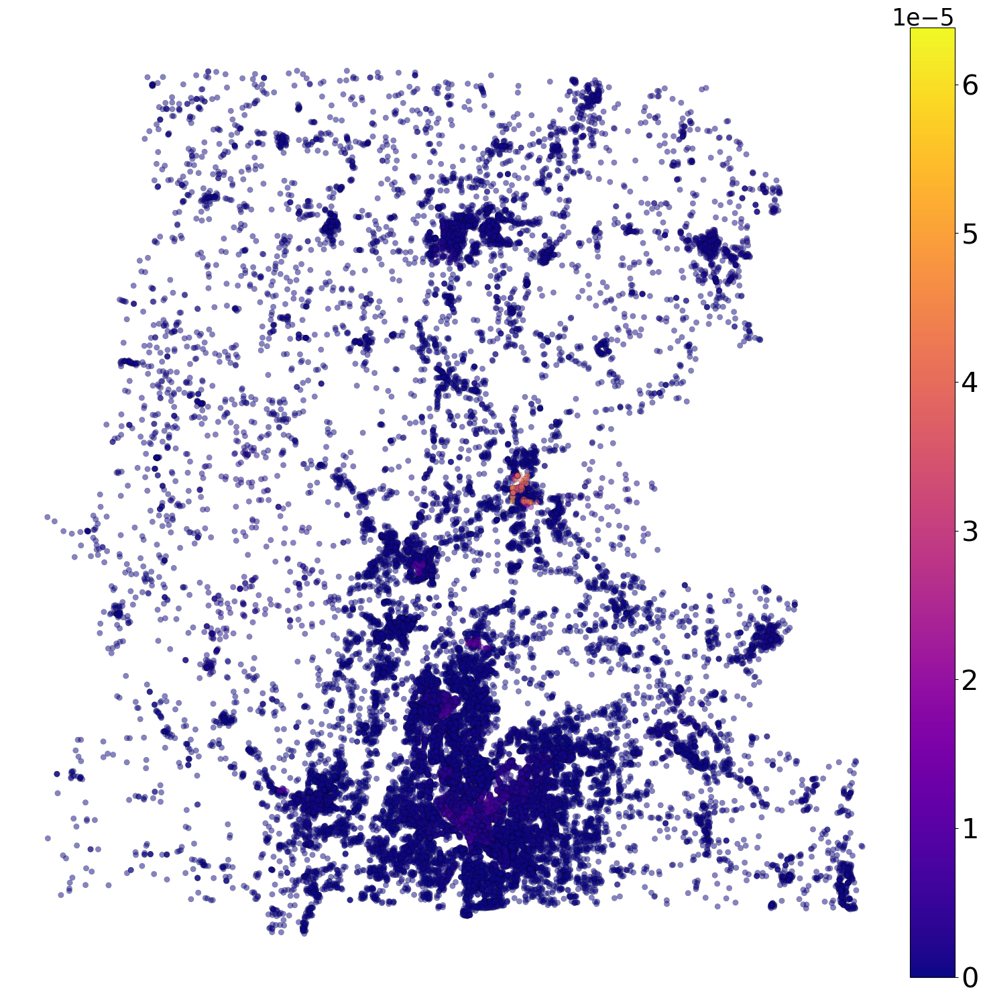

In [39]:
fig, ax = plt.subplots(figsize=(15,15))
divider = make_axes_locatable(ax)
cax = divider.append_axes("right", size="5%", pad=0.1)
gdf.plot('w_rank_inv', cmap='plasma', alpha=0.5, ax=ax, linewidth=.25, edgecolor='k',legend=True, cax=cax)
ax.axis('off')
cax.tick_params(labelsize='30')
cax.yaxis.offsetText.set_fontsize(25)

plt.tight_layout()
plt.savefig('pv-w-rank-invinc.png',dpi=120)

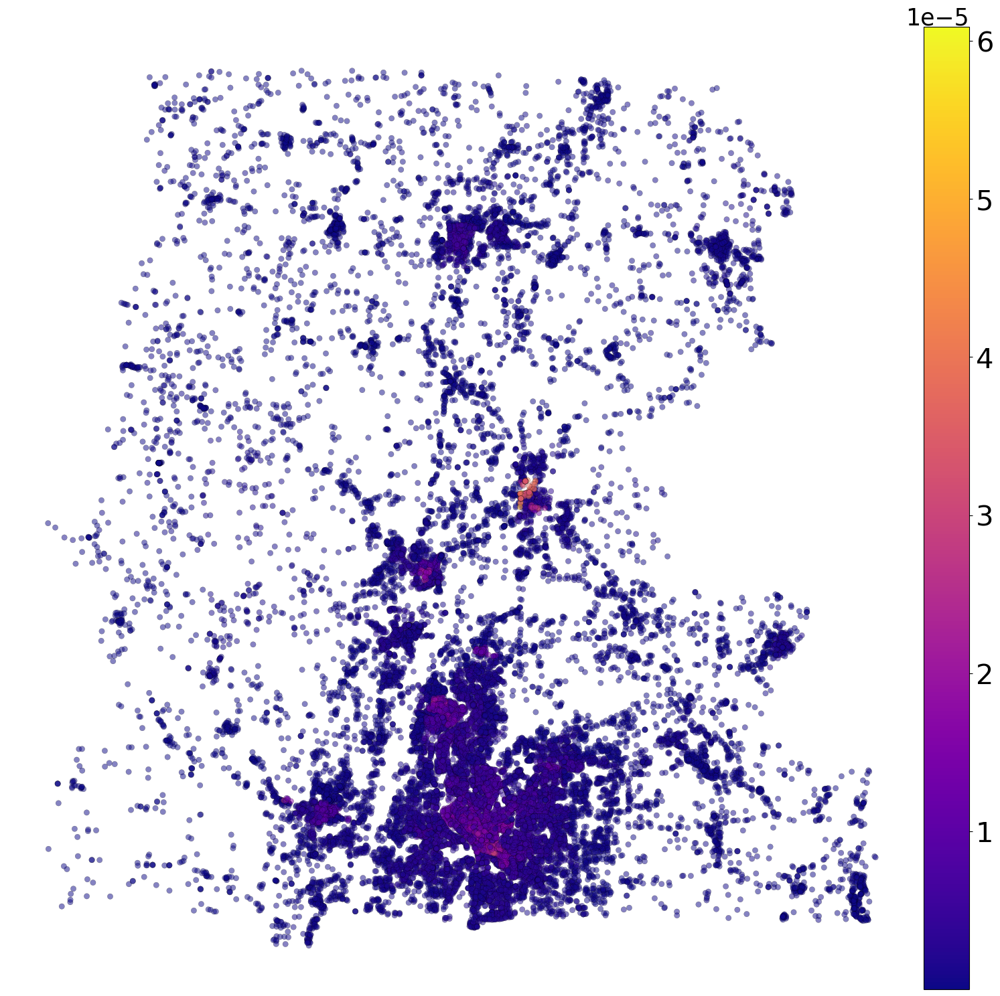

In [40]:
fig, ax = plt.subplots(figsize=(15,15))
divider = make_axes_locatable(ax)
cax = divider.append_axes("right", size="5%", pad=0.1)
gdf.plot('w_rank_bot', cmap='plasma', alpha=0.5, ax=ax, linewidth=.25, edgecolor='k',legend=True, cax=cax)
ax.axis('off')
cax.tick_params(labelsize='30')
cax.yaxis.offsetText.set_fontsize(25)

plt.tight_layout()
plt.savefig('pv-w-rank-both.png',dpi=120)


In [25]:
gdf.columns

Index(['osmid', 'y', 'x', 'street_cou', 'highway', 'ref', 'rank', 'index_righ',
       'GEOID', 'B01003_001', 'B19025A_00', 'NAME', 'state', 'county', 'tract',
       'popden', 'invincome', 'popden_nor', 'invinc_nor', 'w_rank_pde',
       'w_rank_inv', 'w_rank_bot', 'geometry'],
      dtype='object')

In [26]:
gdf['log_popdens']=np.log(gdf['popden'])
gdf['log_inverse_income']=np.log(gdf['invincome'])
gdf['w_rank_log_pde']=gdf['log_popdens']*gdf['rank']
gdf['w_rank_log_inverse_income']=gdf['log_inverse_income']*gdf['rank']
gdf['w_rank_log_both']=(0.5*gdf['log_popdens']+0.5*gdf['log_inverse_income'])*gdf['rank']

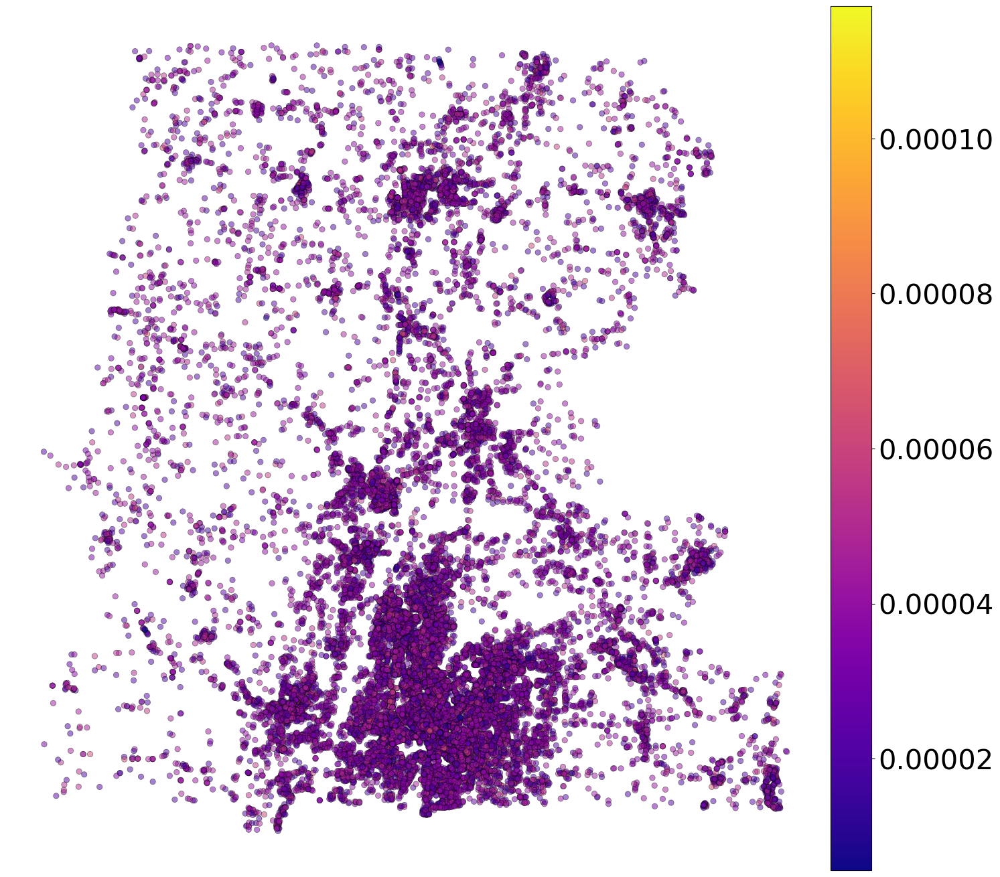

In [27]:
fig, ax = plt.subplots(figsize=(15,15))
divider = make_axes_locatable(ax)
cax = divider.append_axes("right", size="5%", pad=0.1)
gdf.plot('rank', cmap='plasma', alpha=0.5, ax=ax, linewidth=.50, edgecolor='k',legend=True, cax=cax)
ax.axis('off')
cax.tick_params(labelsize='30')
plt.tight_layout()
plt.savefig('pv-page-rank.png',dpi=120)

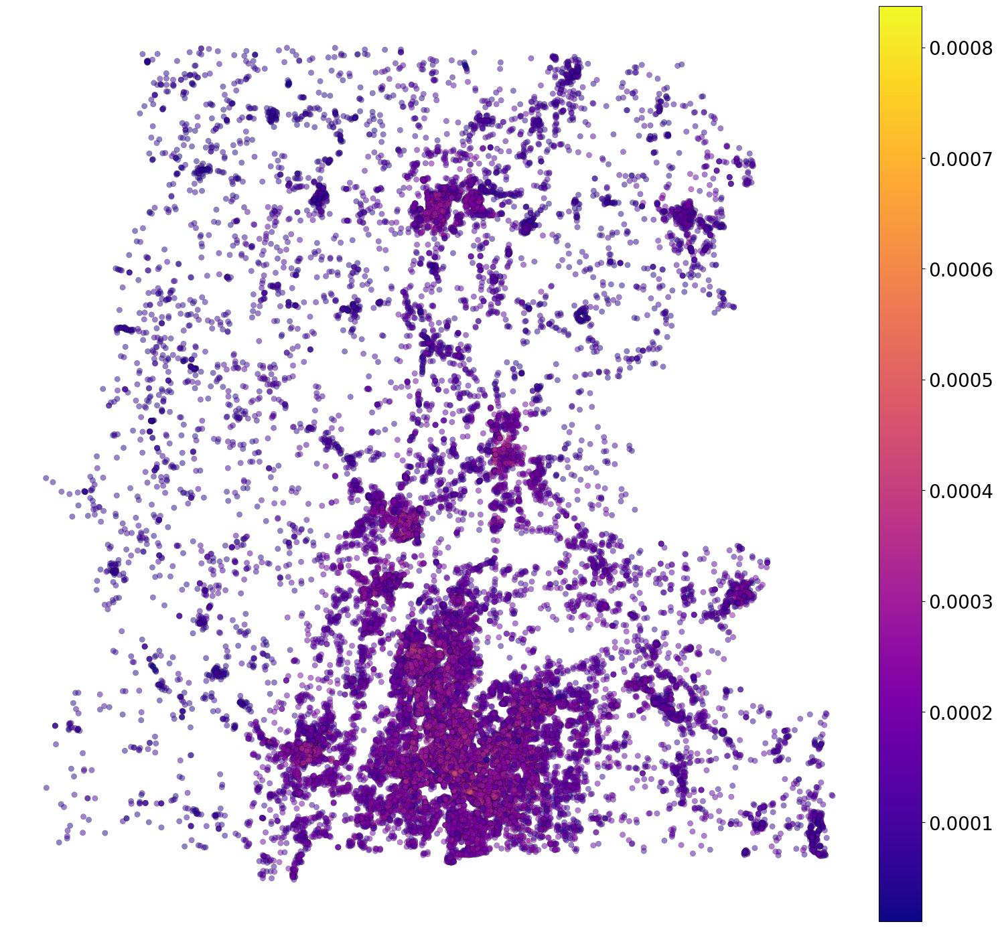

In [28]:
fig, ax = plt.subplots(figsize=(15,15))
divider = make_axes_locatable(ax)
cax = divider.append_axes("right", size="5%", pad=0.1)
gdf.plot('w_rank_log_pde', cmap='plasma', alpha=0.5, ax=ax, linewidth=.25, edgecolor='k',legend=True, cax=cax)
ax.axis('off')
cax.tick_params(labelsize='20')
plt.tight_layout()
plt.savefig('pv-w-rank-popden.png',dpi=120)

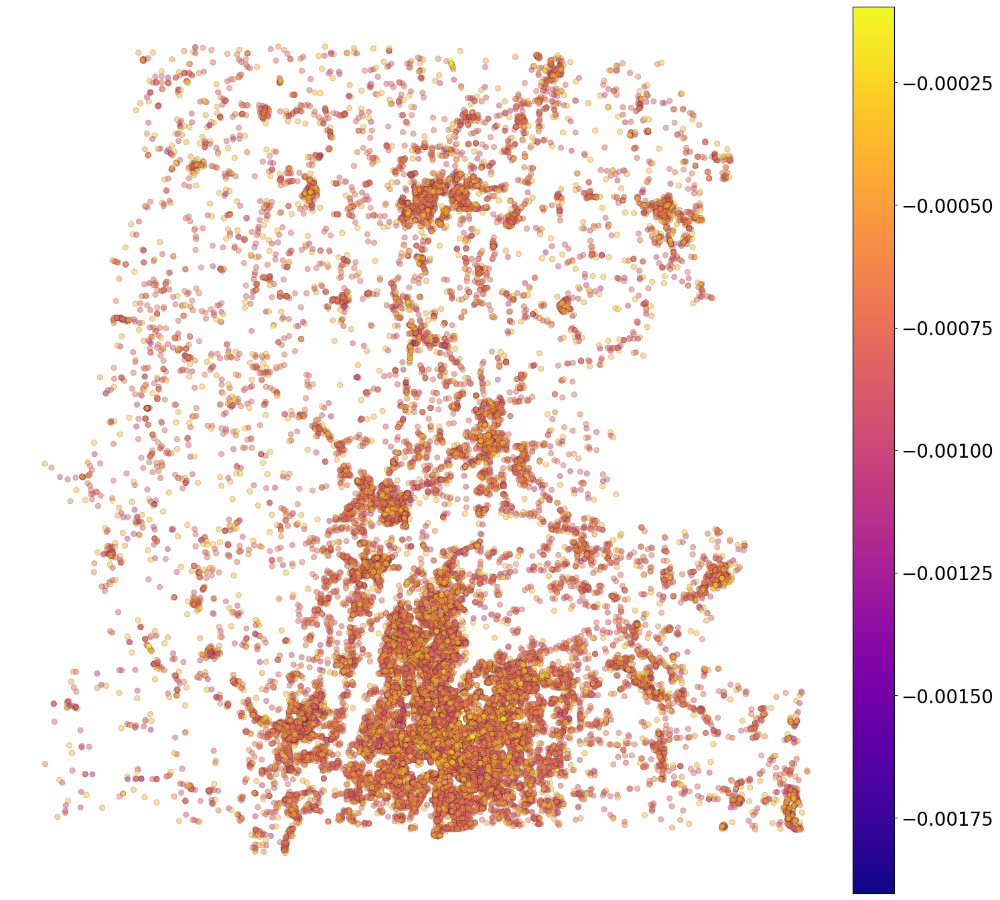

In [29]:
fig, ax = plt.subplots(figsize=(15,15))
divider = make_axes_locatable(ax)
cax = divider.append_axes("right", size="5%", pad=0.1)
gdf.plot('w_rank_log_inverse_income', cmap='plasma', alpha=0.5, ax=ax, linewidth=.25, edgecolor='k',legend=True, cax=cax)
ax.axis('off')
cax.tick_params(labelsize='20')
plt.tight_layout()
plt.savefig('pv-w-rank-invinc.png',dpi=120)

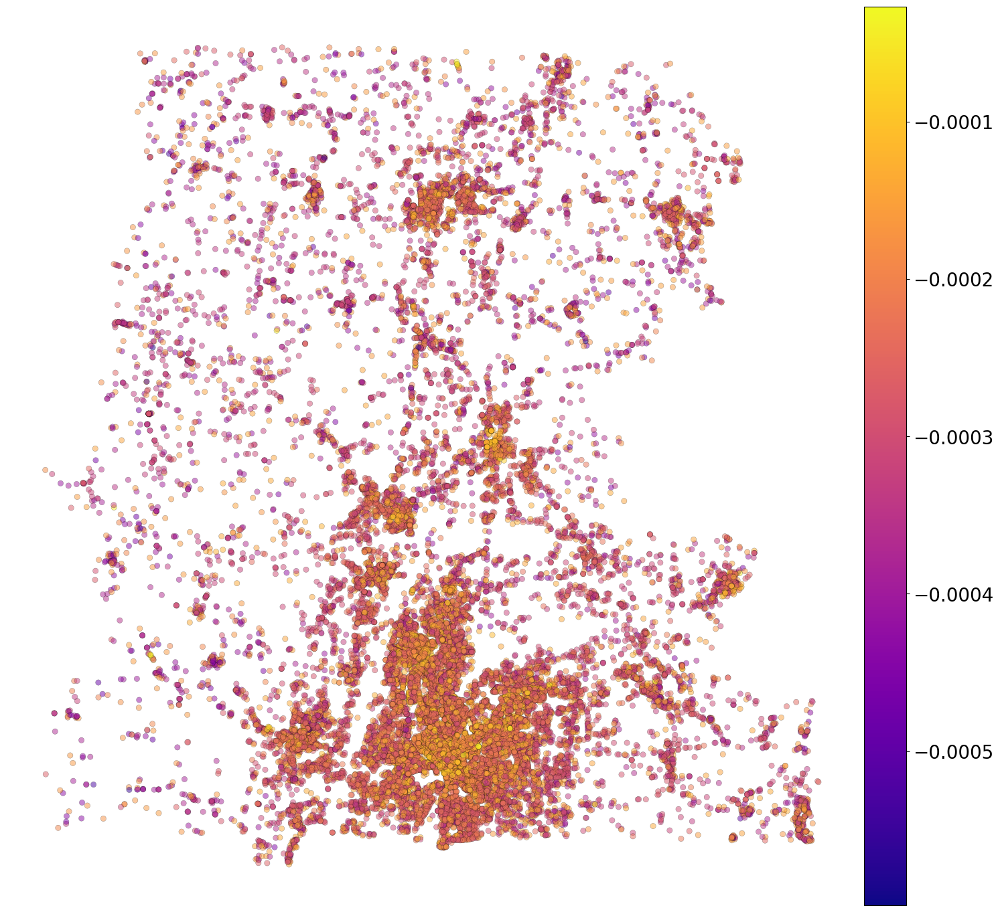

In [30]:
fig, ax = plt.subplots(figsize=(15,15))
divider = make_axes_locatable(ax)
cax = divider.append_axes("right", size="5%", pad=0.1)
gdf.plot('w_rank_log_both', cmap='plasma', alpha=0.5, ax=ax, linewidth=.25, edgecolor='k',legend=True, cax=cax)
ax.axis('off')
cax.tick_params(labelsize='20')
plt.tight_layout()
plt.savefig('pv-w-rank-both.png',dpi=120)